In [1]:
import numpy as np
import matplotlib
matplotlib.rcParams['mathtext.fontset'] = 'cm'
matplotlib.rcParams['font.family'] = 'STIXGeneral'
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
from scipy.stats import multivariate_normal
import matplotlib.patches as mpatches
import cv2
from IPython.display import HTML, Video, clear_output
from base64 import b64encode
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas

In [2]:
to_save_fig = False

# Principle

In [3]:
# utils function
def gaussian(x, mu=0, sigma=1):
    return 1/(sigma*np.sqrt(2*np.pi)) * np.exp(-(x-mu)**2/(2*sigma**2))

def gaussian_2d(x, y, mx=0, my=0, sx=1, sy=1):
    return 1 / (2*sx*sy*np.pi) * np.exp(-((x - mx)**2/(2*sx**2) + (y - my)**2/(2*sy**2)))

## introduction

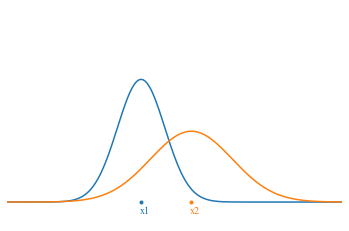

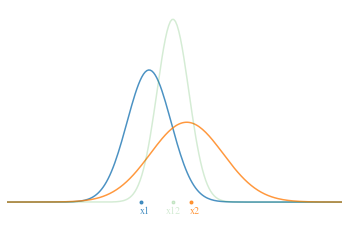

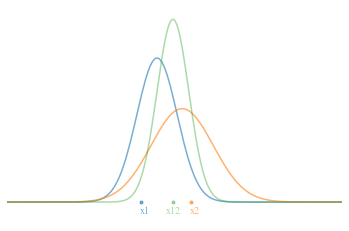

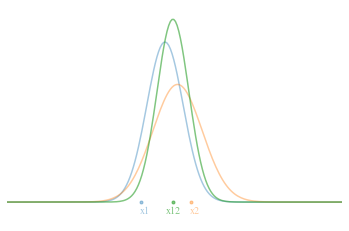

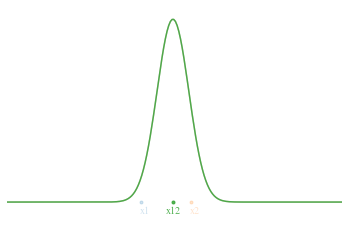

In [4]:
# merged gaussian parameters
mu_1, mu_2, sigma_1, sigma_2 = -1, 0.5, 0.5, 1.5
mu_12    = sigma_1**2/(sigma_1**2+sigma_2**2)*mu_1 + sigma_1**2/(sigma_1**2+sigma_2**2)*mu_2
sigma_12 = sigma_1**2*sigma_2**2/(sigma_1**2+sigma_2**2)

# 2 gaussian paramaters in multiple time step
N = 5
mu_1i, sigma_1i = np.linspace(mu_1,mu_12,N), np.linspace(sigma_1,sigma_12,N)
mu_2i, sigma_2i = np.linspace(mu_2,mu_12,N), np.linspace(sigma_2,sigma_12,N)
x = np.linspace(-5,5,200)
c = ["tab:blue","tab:orange","tab:green"]

# loop on time step
for i in range(N):
    plt.plot(x, gaussian(x, mu_1i[i], np.sqrt(sigma_1i[i])), c=c[0], alpha=1-i/N)
    plt.plot(x, gaussian(x, mu_2i[i], np.sqrt(sigma_2i[i])), c=c[1], alpha=1-i/N)
    plt.plot(x, gaussian(x, mu_12, np.sqrt(sigma_12)), c=c[2], alpha=i/N)
    plt.plot(mu_1i[0], 0, '.', c=c[0], alpha=1-i/N)
    plt.plot(mu_2i[0], 0, '.', c=c[1], alpha=1-i/N)
    plt.plot(mu_12, 0, '.', c=c[2], alpha=i/N)
    plt.text(mu_1i[0]-0.05, -0.05, 'x1', c=c[0], alpha=1-i/N)
    plt.text(mu_2i[0]-0.05, -0.05, 'x2', c=c[1], alpha=1-i/N)
    plt.text(mu_12-0.2, -0.05, 'x12', c=c[2], alpha=i/N)
    plt.axis('off'), plt.xlim([-5,5]), plt.ylim([-0.1,0.9])
    if to_save_fig:
        plt.savefig("fig_"+str(i)+".png", bbox_inches='tight')
    plt.show()

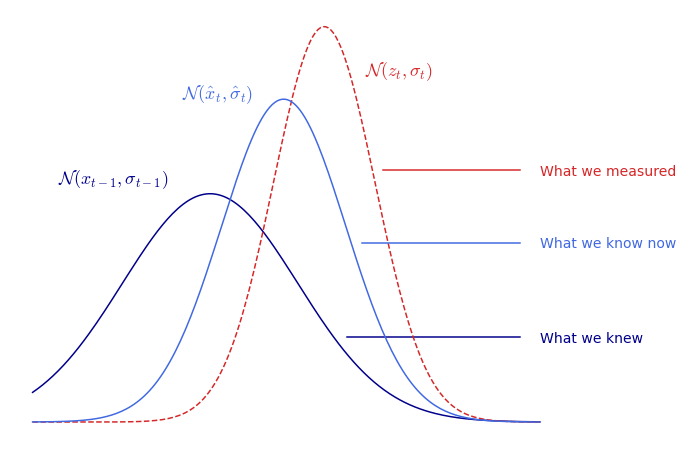

In [5]:
mu_1, mu_2, sigma_1, sigma_2 = -1.5, 0.75, 3, 1
mu_12, sigma_12 = -0.05, 1.5

plt.figure(figsize=(10,8))
# curve left
plt.plot(x, gaussian(x, mu_1, np.sqrt(sigma_1)), c="darkblue")
plt.text(mu_1-3, gaussian(mu_1, mu_1, np.sqrt(sigma_1))+0.01, "$\mathcal{N}(x_{t-1},\sigma_{t-1})$", fontsize=18, c="darkblue")
plt.text(5, gaussian(mu_1, mu_1, np.sqrt(sigma_1))-0.15, "What we knew", fontsize=14, c="darkblue", fontname='DejaVu Sans')
plt.plot([1.2, 4.6], [gaussian(mu_1, mu_1, np.sqrt(sigma_1))-0.145, gaussian(mu_1, mu_1, np.sqrt(sigma_1))-0.145], c="darkblue")
# curve right
plt.plot(x, gaussian(x, mu_2, np.sqrt(sigma_2)), '--', c="tab:red")
plt.text(mu_2+0.8, gaussian(mu_2, mu_2, np.sqrt(sigma_2))-0.05, "$\mathcal{N}(z_t,\sigma_t)$", fontsize=18, c="tab:red")
plt.text(5, gaussian(mu_2, mu_2, np.sqrt(sigma_2))-0.15, "What we measured", fontsize=14, c="tab:red", fontname='DejaVu Sans')
plt.plot([1.9, 4.6], [gaussian(mu_2, mu_2, np.sqrt(sigma_2))-0.145, gaussian(mu_2, mu_2, np.sqrt(sigma_2))-0.145], c="tab:red")
# curve middle
plt.plot(x, gaussian(x, mu_12, np.sqrt(sigma_12)), c="royalblue")
plt.text(mu_12-2, gaussian(mu_12, mu_12, np.sqrt(sigma_12)), "$\mathcal{N}(\hat x_t,\hat \sigma_t)$", fontsize=18, c="royalblue")
plt.text(5, gaussian(mu_12, mu_12, np.sqrt(sigma_12))-0.15, "What we know now", fontsize=14, c="royalblue", fontname='DejaVu Sans')
plt.plot([1.5, 4.6], [gaussian(mu_12, mu_12, np.sqrt(sigma_12))-0.145, gaussian(mu_12, mu_12, np.sqrt(sigma_12))-0.145], c="royalblue")

plt.axis("off")
plt.show()

## 1-dimensional

**create data**

In [6]:
T = 100 # number of points
time = np.linspace(0,1,T)
# linear trajectory
x_true = np.ones(T)
# add noise
x_noised = x_true + 0.1*np.random.randn(T)

**Kalman**

In [7]:
# initialization 
x_est = np.zeros(T)
s_est = 0.5*np.ones(T)
a = 4
w = 2
# kalman filtering
x_est[0] = x_noised[0]
for t in range(1,T):
    # prediction phase
    x_est[t] = a * x_est[t-1] + w
    s_est[t] = a**2 * s_est[t-1]
    # correction phase
    K = s_est[t-1] / (s_est[t-1] + s_est[t])
    x_est[t] = x_est[t-1] + K * (x_noised[t] - x_est[t-1])
    s_est[t] = (1 - K) * s_est[t-1]

**display**

In [8]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)

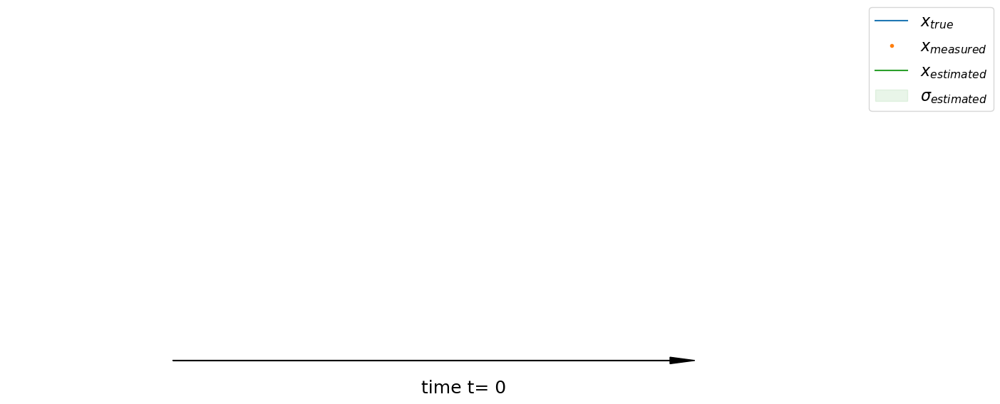

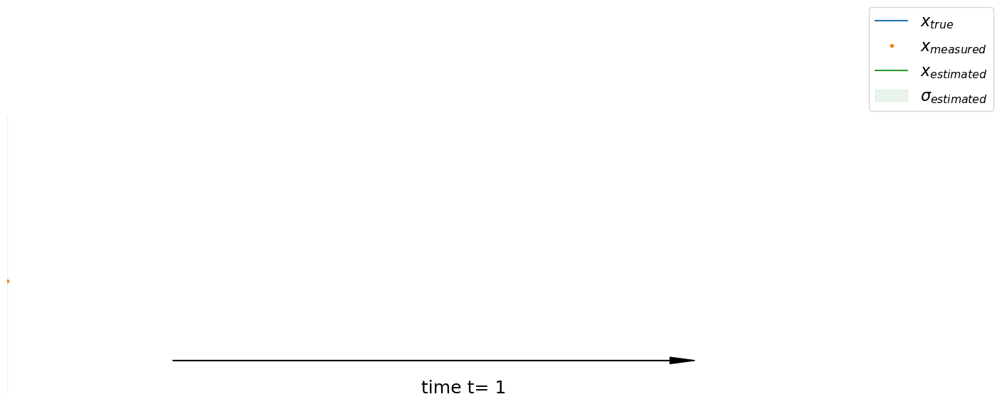

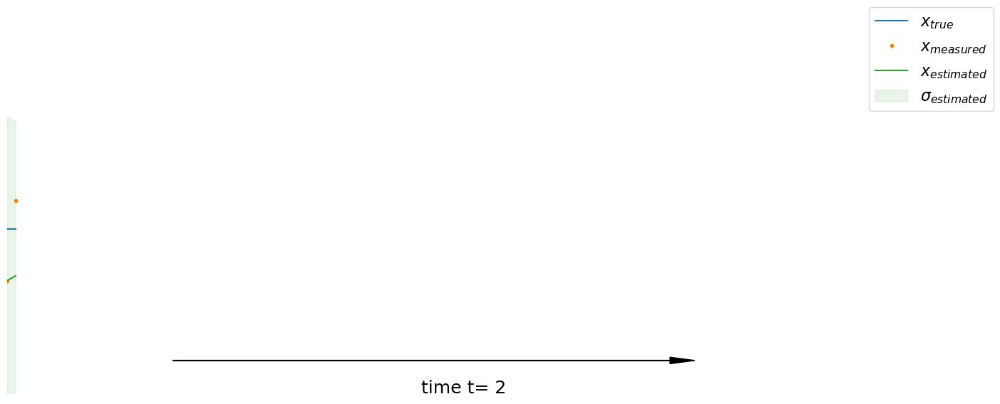

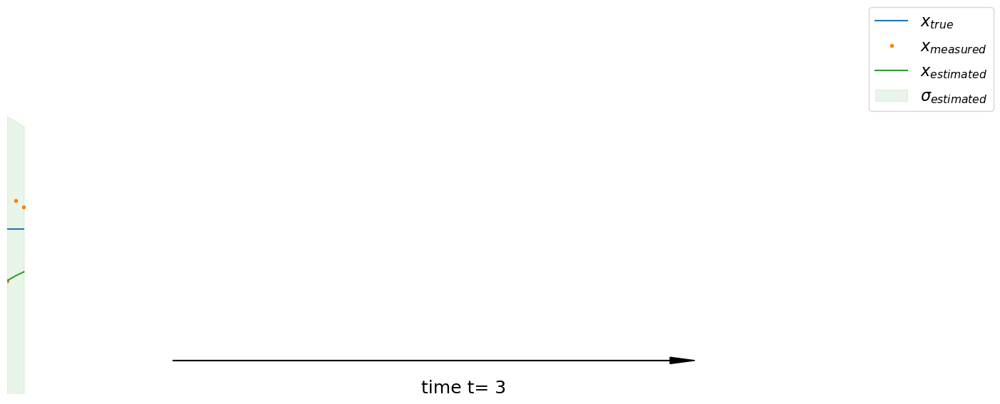

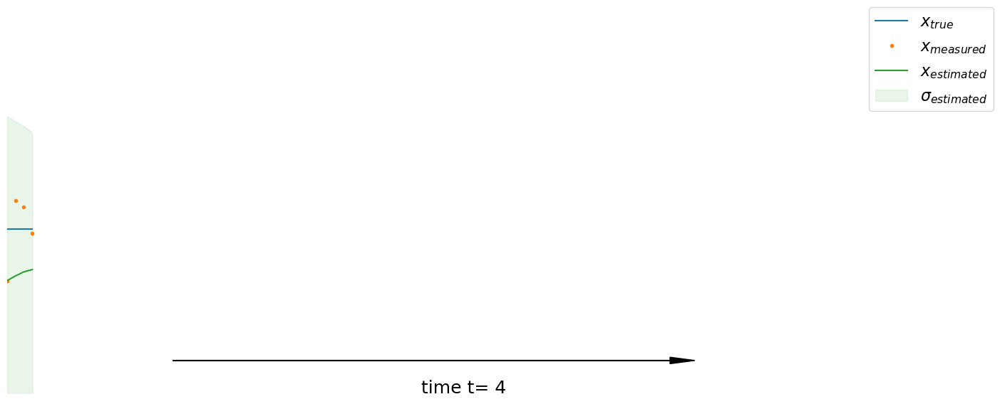

...

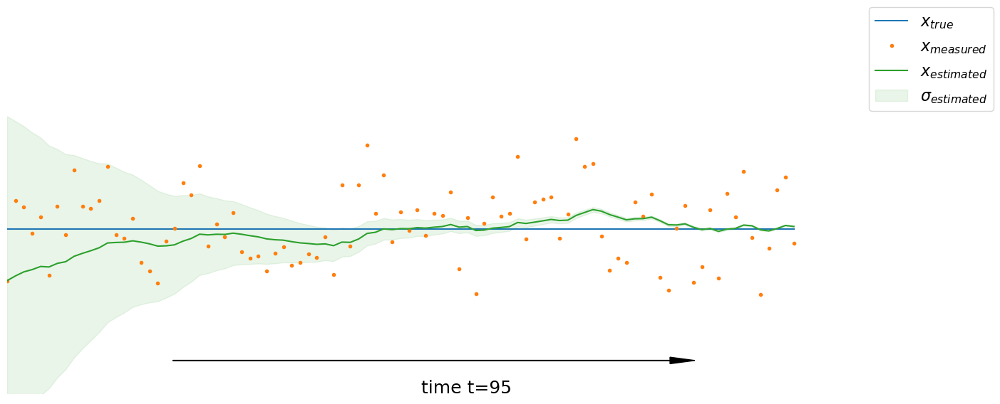

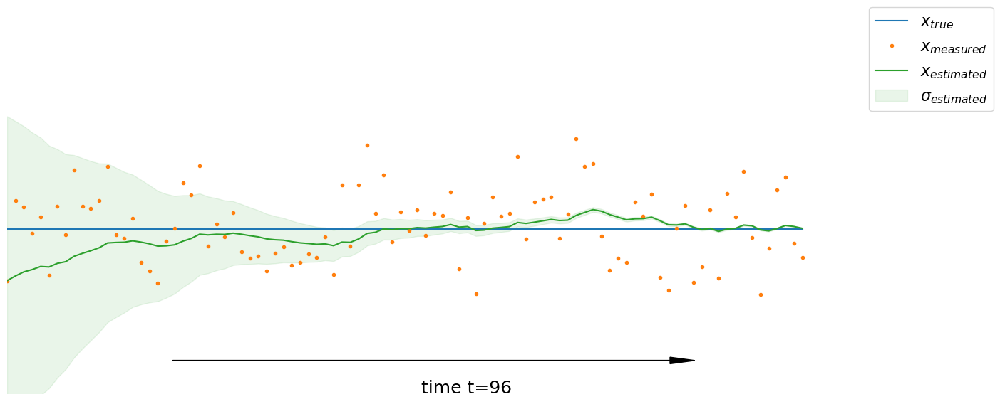

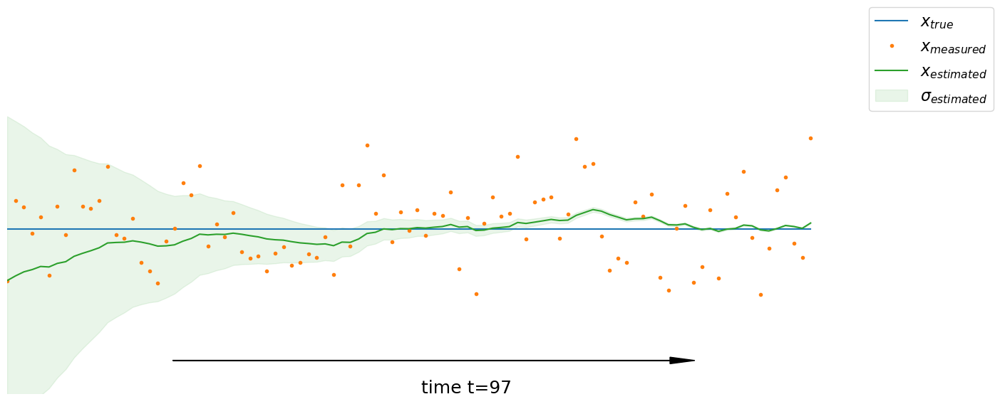

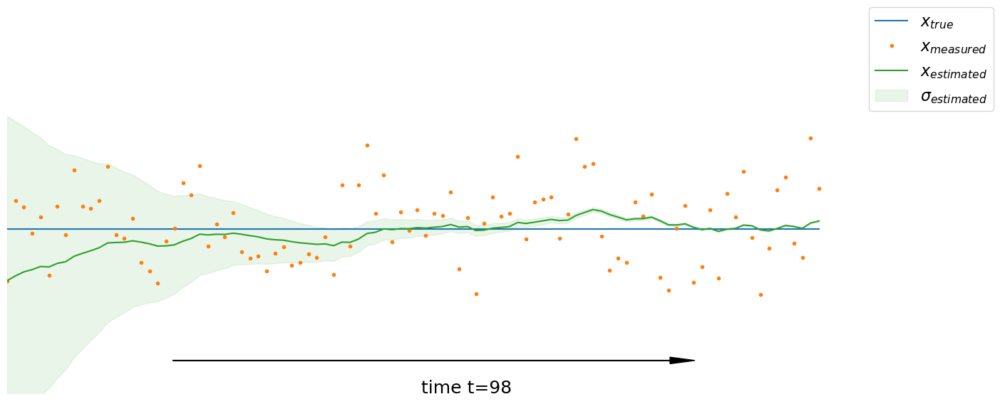

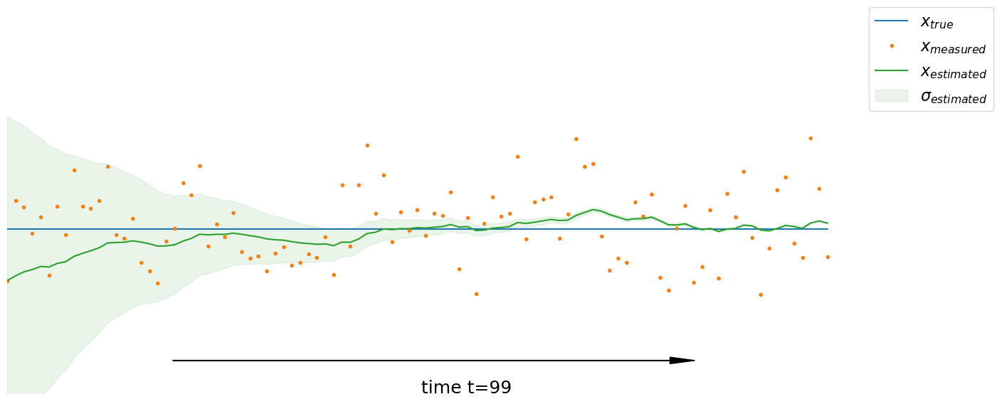

In [9]:
# loop on time step
for t in range(T):
    plt.figure(figsize=(15,6))
    plt.plot(time[:t], x_true[:t])
    plt.plot(time[:t], x_noised[:t], '.')
    plt.plot(time[:t], x_est[:t], "tab:green")
    plt.fill_between(time[:t], x_est[:t]-s_est[:t], x_est[:t]+s_est[:t], alpha=0.1, color="tab:green")
    plt.arrow(0.2, 0.6, 0.6, 0,head_width=.02,color="k")
    plt.text(0.5,0.5,"time t={:2d}".format(t), fontsize=18)
    plt.ylim([0.5,1.5]), plt.xlim([0,1])
    plt.legend(["$x_{true}$", "$x_{measured}$", "$x_{estimated}$","$\sigma_{estimated}$"], fontsize=16, bbox_to_anchor=(1.2, 1.2))
    plt.axis("off")
    if to_save_fig:
        plt.savefig("fig_"+str(t)+".png", bbox_inches='tight')
    plt.show()

## 2-dimensional


**create data**

In [10]:
trajectory = "circle" #circle #line

In [11]:
# discretization
T = 200 
# trajectory
if trajectory == "circle":
    r = 2
    theta = np.linspace(0, 2*np.pi + 0.3, T)
    X_true = np.array([r*np.cos(theta), r*np.sin(theta)]).T
elif trajectory == "line":
    X1 = np.linspace(0.5, 2.5, T)
    X2 = np.linspace(0.5, 2.5, T)
    X_true = np.vstack((X1, X2)).T
else:
    print("unknown trajectory")
# add noise
X_noised = X_true + 0.08*np.random.randn(T,2) # 0.2

**kalman**

In [12]:
D = 2 # dimension

# kalman parameters 
A = np.eye(D)        # state transition matrix 
Q = 0.01 * np.eye(D) # noise process covariance matrix (model noise)
R = 0.1 * np.eye(2)  # noise measure covariance matrix (sensor noise)
H = np.eye(2)        # observation matrix

# initial state
X_est = np.zeros((T,D))
S_est = np.zeros((T,D,D))
X_est[0,:] = X_noised[0,:]
S_est[0,:,:] = 0.2 * np.array([[1.,.5],[.5,1.]]) # np.ones((D,D))

# temporal loop with kalman estimation
for t in range(1,T):
    
    # prediction phase
    X_est[t,:] = A @ X_est[t-1,:]
    S_est[t,:,:] = (A @ S_est[t-1,:,:]) @ A.T + Q
        
    # correction phase
    K = (S_est[t,:,:] @ H.T ) @ np.linalg.inv((H @ S_est[t,:,:]) @ H.T + R)
    X_est[t,:]   = X_est[t-1,:] + K @ (X_noised[t,:] - H @ X_est[t-1,:])
    S_est[t,:,:] = S_est[t,:,:] - (K @ H) @ S_est[t,:,:]

**display**

In [13]:
# compute gaussian values
N = 200
xs, ys, zs = np.zeros((T,N,N)), np.zeros((T,N,N)), np.zeros((T,N,N))
for t in range(T):
    x, y = np.meshgrid(np.linspace(X_est[t,0]-5*S_est[t,0,0], X_est[t,0]+5*S_est[t,0,0], N), np.linspace(X_est[t,1]-5*S_est[t,1,1], X_est[t,1]+5*S_est[t,1,1], N))
    rv = multivariate_normal(X_est[t,:], S_est[t,:,:], allow_singular=True)
    z = rv.pdf(np.dstack((x, y)))
    z = z/np.linalg.norm(z) 
    xs[t,...], ys[t,...], zs[t,...] = x, y, z

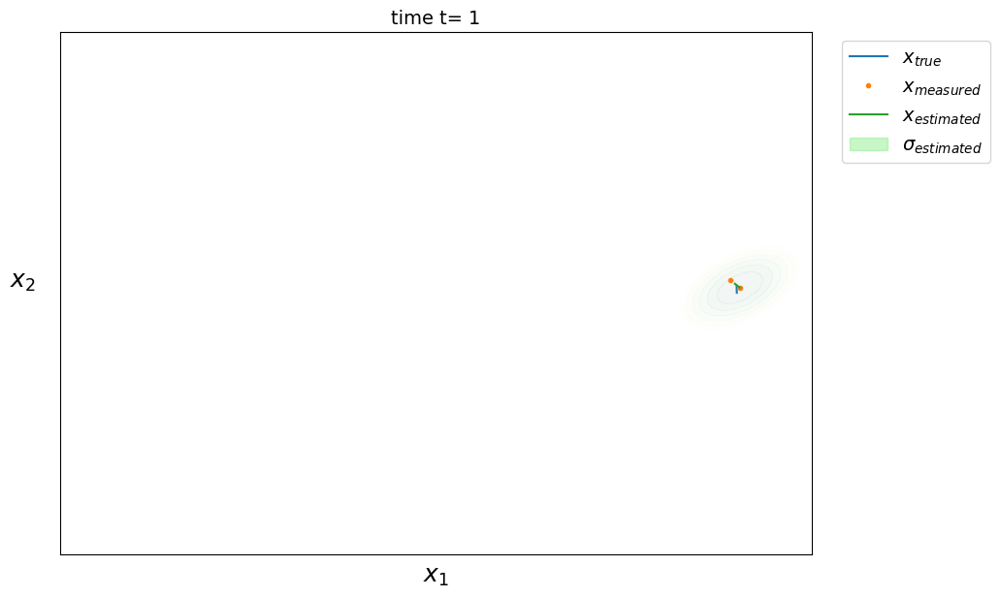

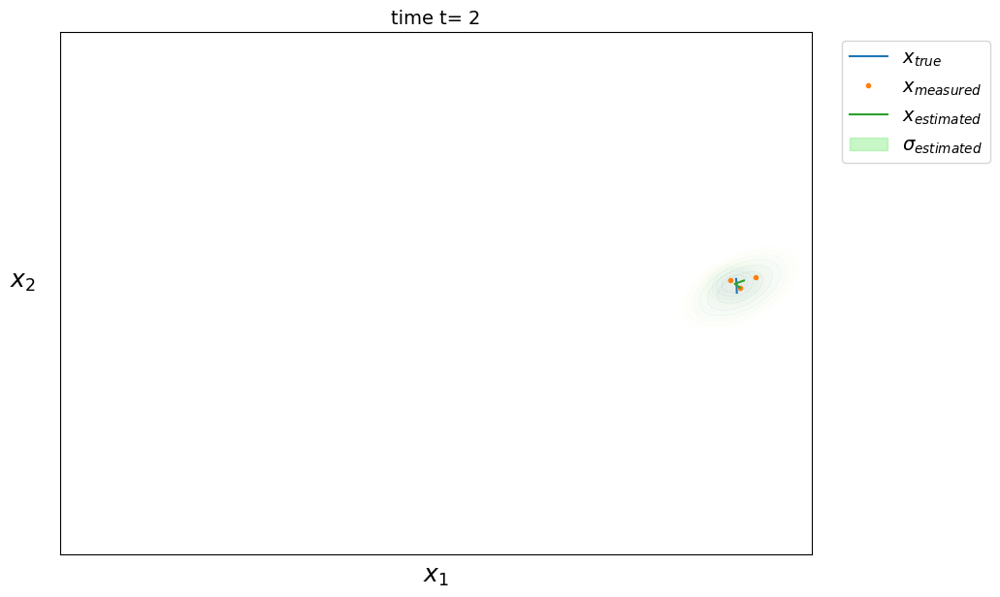

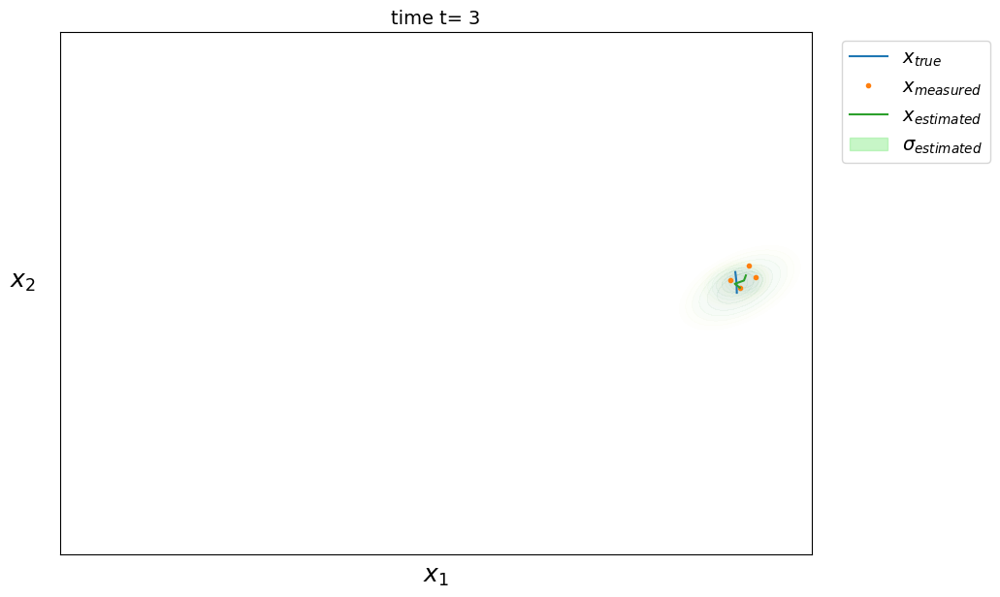

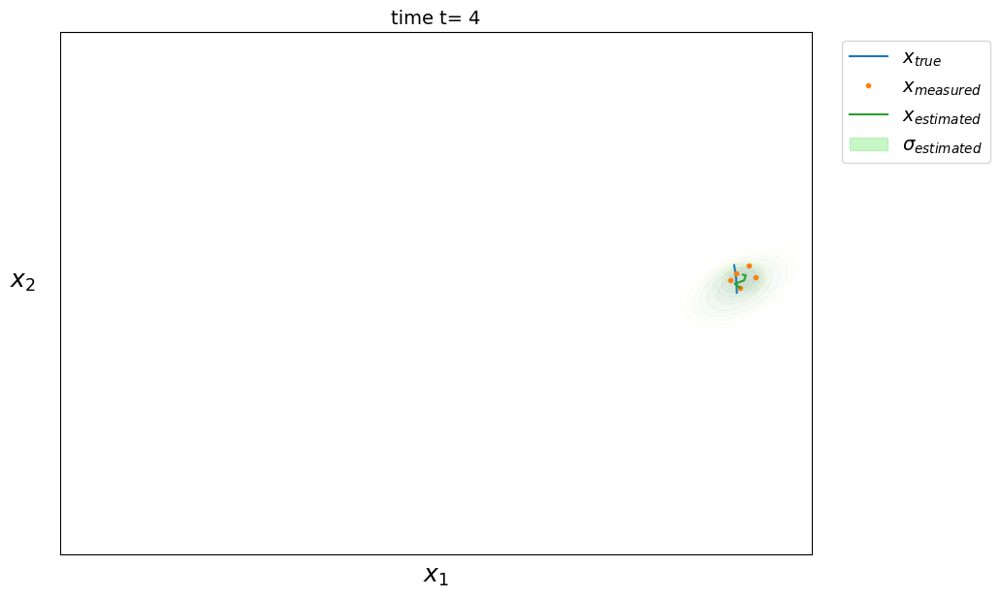

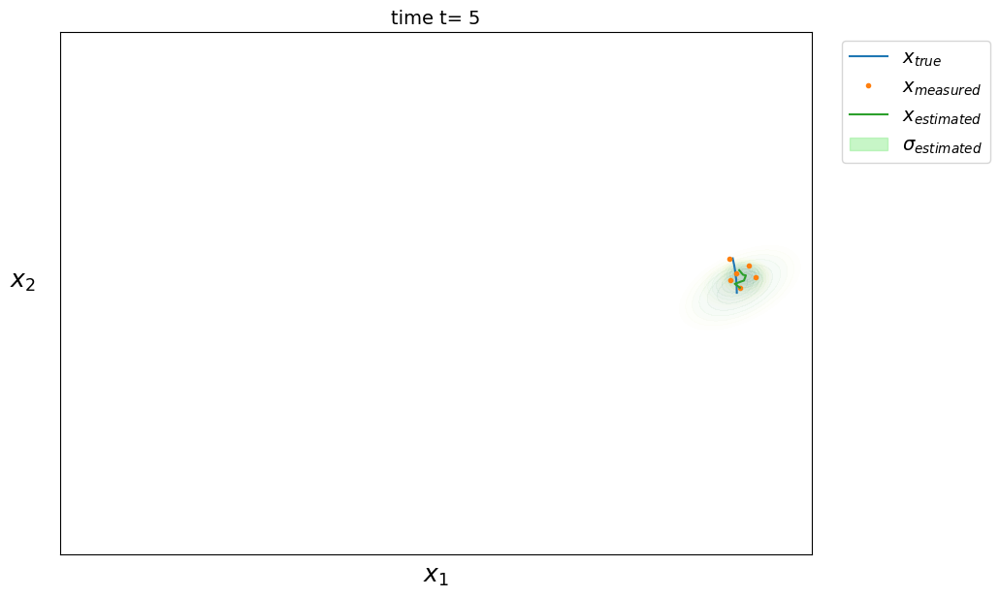

...

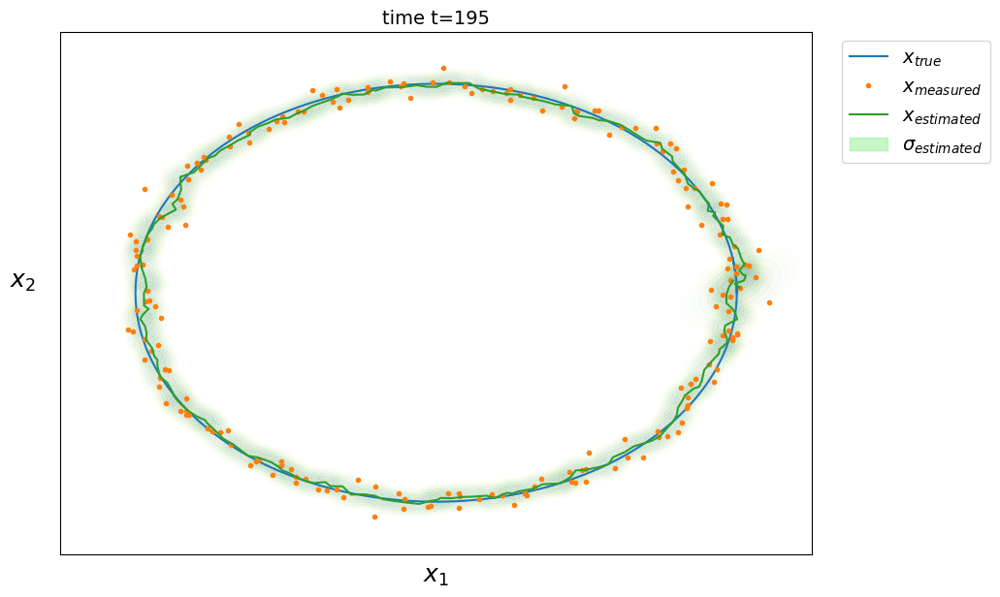

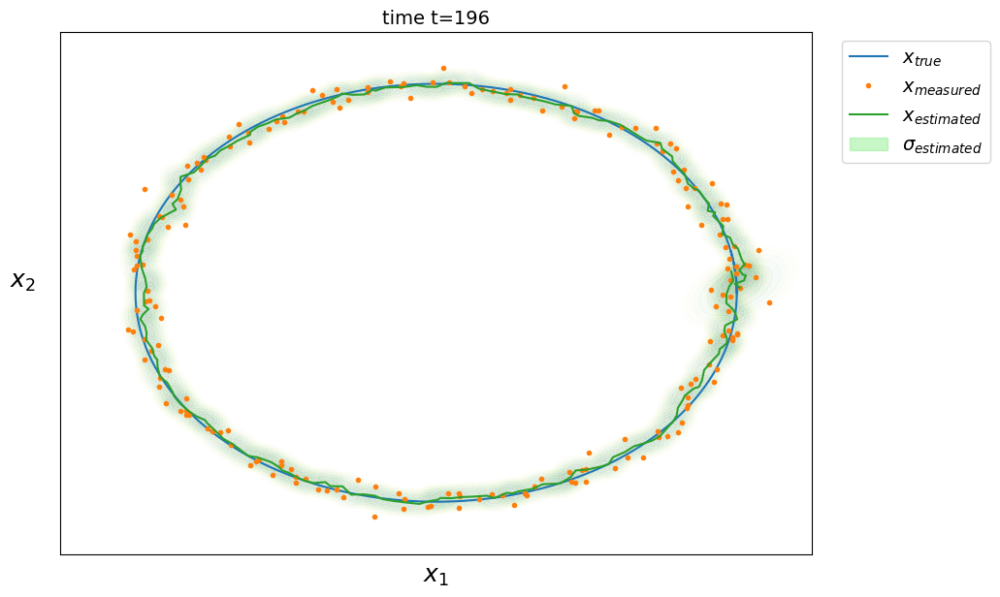

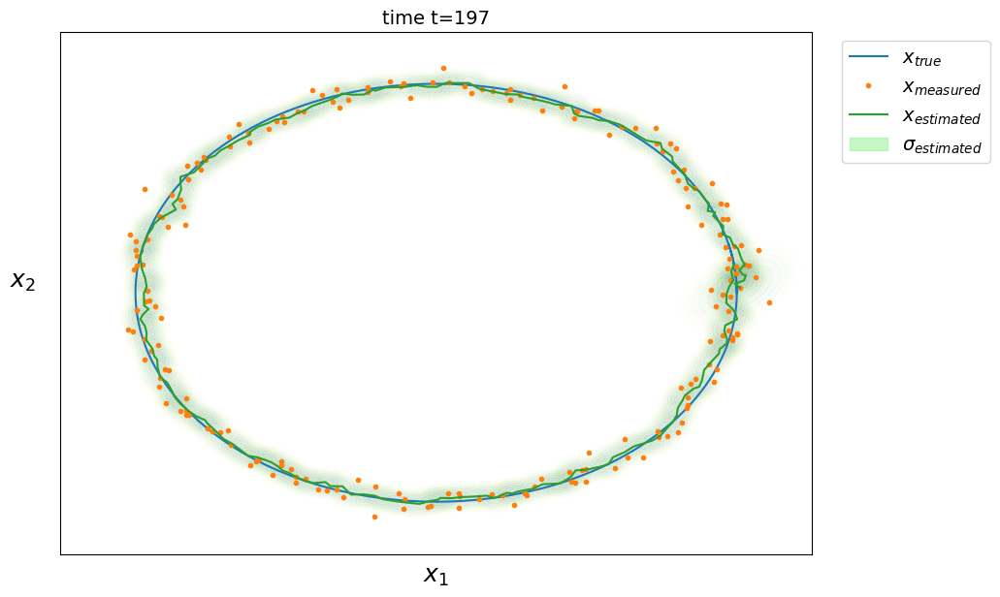

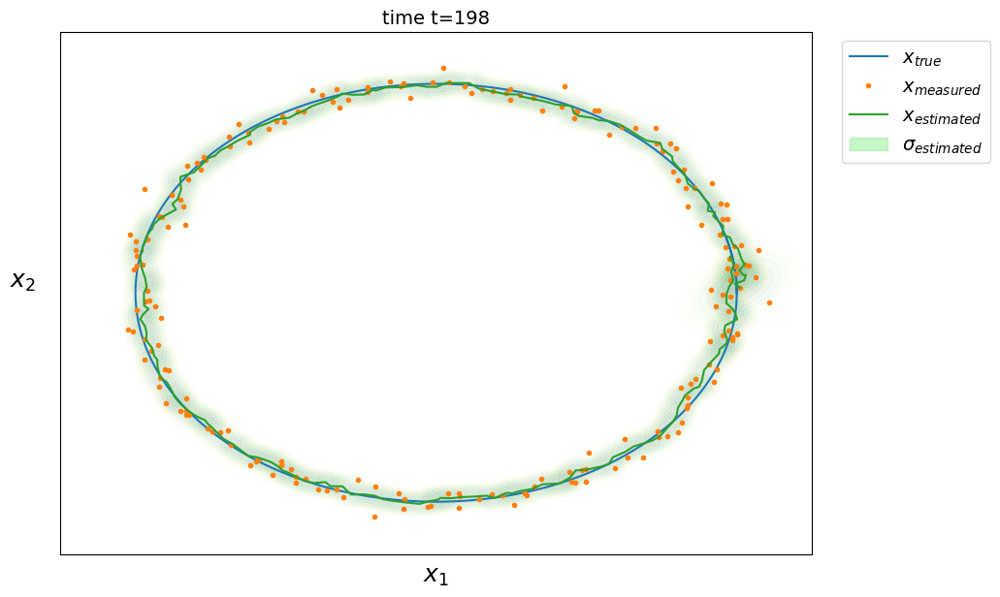

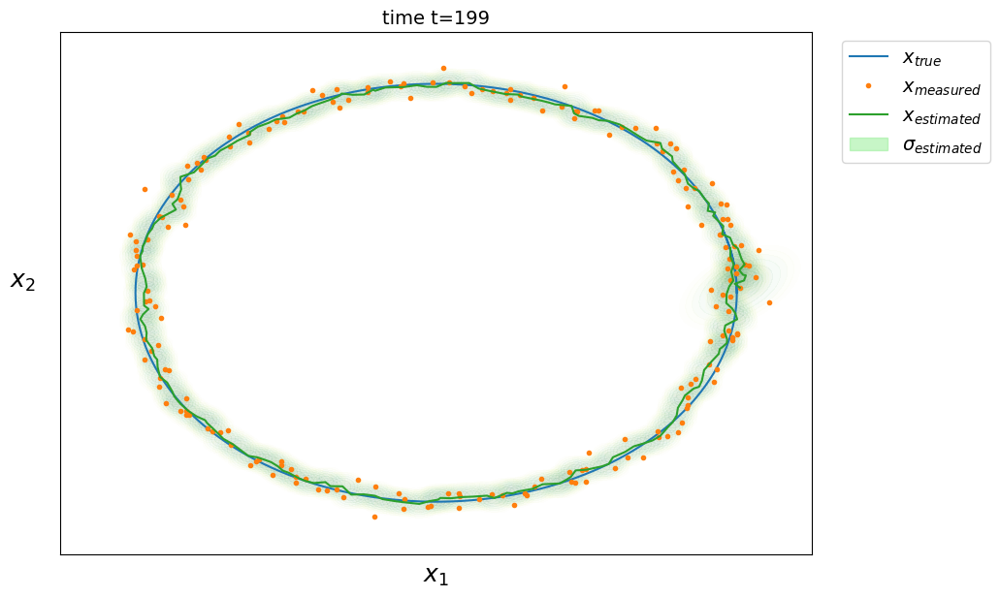

In [14]:
levels = 1e-2*np.array([0.1, 0.4, 0.6, 0.8, 1.2])
green_patch = mpatches.Patch(color='lightgreen', alpha=0.5, label="$\sigma_{estimated}$")

for t in range(1,T):
    
    plt.figure(figsize=(10,7))
    plt.plot(X_true[:t+1,0], X_true[:t+1,1], label="$x_{true}$")
    plt.plot(X_noised[:t+1,0], X_noised[:t+1,1], '.', label="$x_{measured}$")
    plt.plot(X_est[:t+1,0], X_est[:t+1,1], label="$x_{estimated}$")
    for k in range(0,t):
        levels = np.linspace(zs[k,:,:].max()/1.5, zs[k,:,:].max(), 7)
        plt.contourf(xs[k,:,:], ys[k,:,:], zs[k,:,:], alpha=0.05, cmap="YlGn", levels=levels)

    plt.xlabel("$x_1$", fontsize=18), plt.ylabel("$x_2$", fontsize=18, rotation=0), plt.gca().yaxis.set_label_coords(-.05,.5)
    plt.xlim((-2.5,2.5)), plt.ylim((-2.5,2.5))
    handles, labels = plt.gca().get_legend_handles_labels()
    handles.extend([green_patch]) 
    plt.legend(handles=handles, fontsize=14, bbox_to_anchor=(1.25, 1.))
    plt.title("time t={:2d}".format(t), fontsize=14)
    plt.xticks(()), plt.yticks(())
    if to_save_fig:
        plt.savefig("fig_"+str(t)+".png", bbox_inches='tight')
    plt.show()

# Kalman Function

$ \hat X_t = \hat X_t + K (H Z_t - \hat X_t) $

$ \hat P_t = \hat P_t - K H \hat P_t $

avec le gain de Kalman $ K = \hat P_t H^t (H \hat P_t H^T + R)^{-1} $

In [2]:
def kalman_estimation(X_est, P_est, Z_obs):
    # state prediction
    X_est = A @ X_est
    P_est = A @ P_est @ A.T + Q  
    # observation
    Z_pred = H @ X_est
    # kalman gain
    K = P_est @ H.T @ np.linalg.inv(H @ P_est @ H.T + R)
    # correction phase
    if list(Z_obs):
        X_est = X_est + K @ (Z_obs - Z_pred)
        P_est = P_est - K @ H @ P_est
    # return final estimation
    return X_est, P_est

# Object Tracking

Following the movement equation : $x_{t+1} = x_t + \Delta t \ \dot x_t$ where $x$ is the position and $\dot x$ the velocity


We have then for our 2D problem


$ 
\left\{
  \begin{array}{cc}
    x_{t+1}      &=&  1 x_t &+&  0 y_t  &+& \Delta t \ \dot x_t &+&    0       \dot y_t \\
    y_{t+1}      &=&  0 x_t &+&  1 y_t  &+&    0       \dot x_t &+& \Delta t \ \dot y_t \\
    \dot x_{t+1} &=&  0 x_t &+&  0 y_t  &+&            \dot x_t &+&    0       \dot y_t \\
    \dot y_{t+1} &=&  0 x_t &+&  0 y_t  &+&    0       \dot x_t &+&    1       \dot y_t
  \end{array}
\right.
$


## Initialization

In [4]:
# Initial state
X = np.array([500, 500, 0, 0])
P = np.eye(4)

# Kalman parameters
dt = 0.1
A = np.array([[1, 0, dt, 0], [0, 1, 0, dt], [0, 0, 1, 0], [0, 0, 0, 1]])
H = np.array([[1, 0, 0, 0],  [0, 1, 0, 0]])
Q = np.eye(4)
R = np.eye(2)

# to keep track of history
X_hist = []
Z_hist = []

## object detector

In [12]:
def simple_detector(image):
    # go to HSV space
    image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    # look into interval
    mask = cv2.inRange(image, np.array([155, 50, 50]) , np.array([170, 255, 255]))
    # sort by contour
    obj = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[-2]
    obj = sorted(obj, key=lambda x:cv2.contourArea(x), reverse=True)
    # keep center point
    if obj:
        (cX, cY), _ = cv2.minEnclosingCircle(obj[0])
        Z = [cX, cY]
    # return empty if no detection 
    else:
        Z = []
    return Z

## Get data

In [5]:
cap = cv2.VideoCapture(r'C:\Users\julien.LAPTOP-V4T667QN\Pictures\Camera Roll\video.mp4')

## Estimation loop

IndexError: list index out of range

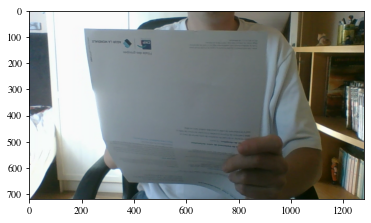

In [13]:
# video loop
t = 0
while True:
    
    # get frame
    ret, frame = cap.read()
    if not ret:
        break
    
    # simple object detection
    Z_obs = simple_detector(frame)

    # kalman filter
    if t == 0:
        X = np.array([Z_obs[0], Z_obs[1], 0, 0])
    X, P = kalman_estimation(X, P, Z_obs)
    t = t+1

    # Store the last 10 states
    X_hist.append(X.copy())
    Z_hist.append(Z_obs.copy())
    if len(X_hist) > 10:
        X_hist.pop(0)
    if len(Z_hist) > 10:
        Z_hist.pop(0)

    # displaying
    fig = plt.figure()
    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.plot(Z_obs[0], Z_obs[1], 'r.', label="detected")
    plt.plot(X[0], X[1], 'g.', label="kalman")
    plt.arrow(X[0], X[1], X[2], X[3], color='g', head_length=1.5)
    for k, (x_hist, z_hist) in enumerate(zip(X_hist, Z_hist)):
        plt.scatter(x_hist[0], x_hist[1], c='g', s=5, alpha=k/20)
        if z_hist:
            plt.scatter(z_hist[0], z_hist[1], c='r', s=5, alpha=k/20)
    plt.legend(loc="upper right")
    plt.axis("off")

    # put pixel buffer in numpy array
    canvas = FigureCanvas(fig)
    canvas.draw()
    mat = np.array(canvas.renderer._renderer)
    mat = cv2.cvtColor(mat, cv2.COLOR_RGB2BGR)

    # Display the video frame in the notebook
    _, jpeg = cv2.imencode('.jpg', mat)
    data_uri = 'data:image/jpeg;base64,' + b64encode(jpeg).decode('utf-8')
    display(HTML('<img src="%s" class="blog-image">' % data_uri))
    clear_output(wait=True)
    plt.close()

cap.release()

# IMU : accelerometer and gyroscope

## Create data

In [216]:
dt = 0.05 # time step
T = 10 # total time
N = int(T/dt)
times = np.arange(0, T, dt) # time array
# Define state vector to be estimated (normally unknown)
X_true = np.zeros((N, 3))
X_true[:, 0] = -1 * np.pi * np.cos(np.pi * times) + np.pi
X_true[:, 1] = np.diff(X_true[:,0], prepend=-np.pi*dt)/dt # np.pi ** 2 * np.sin(np.pi * times)
X_true[:, 2] = 10 * times + 20 * np.sin(2 * np.pi * 0.1 * times)
# Noise sensors
noise = np.zeros((N,2))
s = np.array([np.pi*0.2, np.pi**2*0.5])
noise[:,0] = s[0] * np.random.randn(N)
noise[:,1] = s[1] * np.random.randn(N)
# Generate observation
X_obs = np.zeros((N, 2))
X_obs[:, 0] = X_true[:, 0] + noise[:,0]
X_obs[:, 1] = X_true[:, 1] + X_true[:, 2] + noise[:,1]

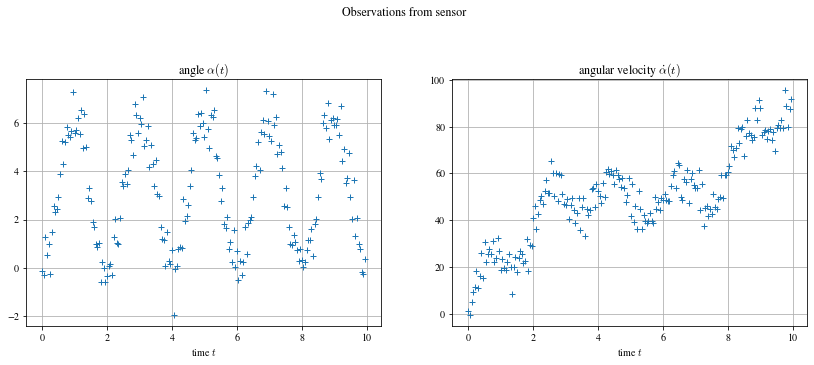

In [234]:
plt.figure(figsize=(14,10))
# accelerometer
plt.subplot(2, 2, 1), plt.grid()
plt.plot(times, X_obs[:,0], '+'),
plt.title(r"angle $\alpha (t)$"), plt.xlabel('time $t$')
# gyroscope
plt.subplot(2, 2, 2), plt.grid()
plt.plot(times, X_obs[:,1], '+') 
plt.title(r"angular velocity $\dot \alpha (t)$"), plt.xlabel('time $t$')
plt.suptitle("Observations from sensor")
plt.show()

## Initialization

In [225]:
# Kalman filter parameter
H = np.array([[1,0,0],[0,1,1]])
R = np.array([[s[0]**2,0],[0,s[1]**2]])
A = np.array([[1,dt,0],[0,1,0],[0,0,1]])
Q = np.array([[0,0,0],[0,3,0],[0,0,5]])

In [226]:
# initial state
X_est = np.zeros(3)
P_est = np.zeros((3,3))
X_kalman = np.zeros((N, 3))

## Estimation loop

In [227]:
# loop over time
for t in range(2,N):
    X_est, P_est = kalman_estimation(X_est, P_est, X_obs[t, :].T)
    # save history
    X_kalman[t, :] = X_est

## Display

In [238]:
# residual error
print("error on X0 : kalman={:.2f} ; observation={:.2f}".format(np.sum((X_true[:,0]-X_kalman[:,0])**2), np.sum((X_true[:,0]-X_obs[:,0])**2)))
print("error on X1 : kalman={:.2f} ; observation={:.2f}".format(np.sum((X_true[:,1]-X_kalman[:,1])**2), np.sum((X_true[:,1]-X_obs[:,1])**2)))

error on X0 : kalman=38.75 ; observation=80.03
error on X1 : kalman=2007.31 ; observation=575873.43


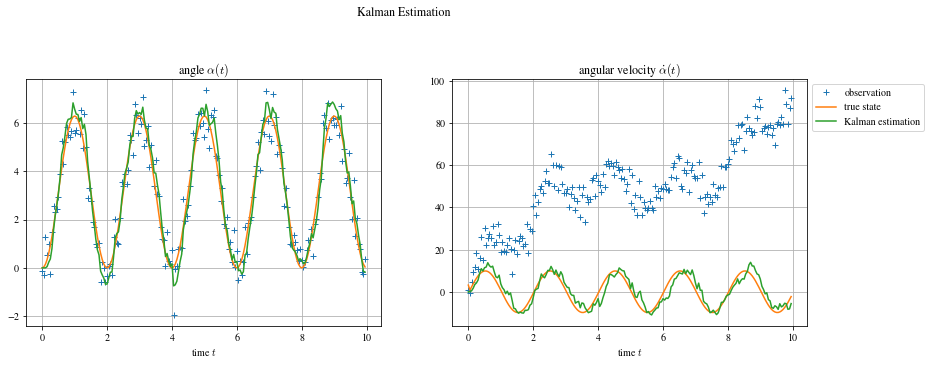

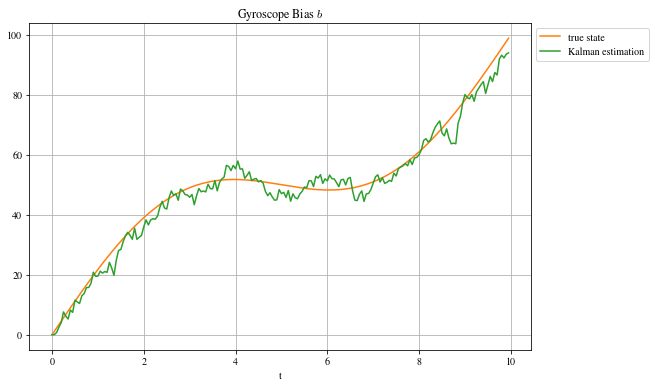

In [256]:
plt.figure(figsize=(14,10))
# accelerometer
plt.subplot(2, 2, 1), plt.grid()
plt.plot(times, X_obs[:,0], '+'), plt.plot(times, X_true[:,0]), plt.plot(times, X_kalman[:,0])
plt.title(r"angle $\alpha (t)$"), plt.xlabel('time $t$')
# gyroscope
plt.subplot(2, 2, 2), plt.grid()
plt.plot(times, X_obs[:,1], '+', label='observation') 
plt.plot(times, X_true[:,1], label='true state')
plt.plot(times, X_kalman[:,1], label='Kalman estimation')
plt.title(r"angular velocity $\dot \alpha (t)$"), plt.xlabel('time $t$')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.suptitle("Kalman Estimation")
# bias
plt.figure(figsize=(9,6)), plt.grid()
plt.plot(times, X_true[:,2], "tab:orange", label="true state"), plt.plot(times, X_kalman[:,2], "tab:green", label="Kalman estimation")
plt.title("Gyroscope Bias $b$"), plt.xlabel('t'), plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.show()